<a href="https://colab.research.google.com/github/naman065/HUMANOID-/blob/main/Humanoid_CV_Task1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!pip install opencv-python-headless


Saving New Project - Made with Clipchamp.mp4 to New Project - Made with Clipchamp (8).mp4


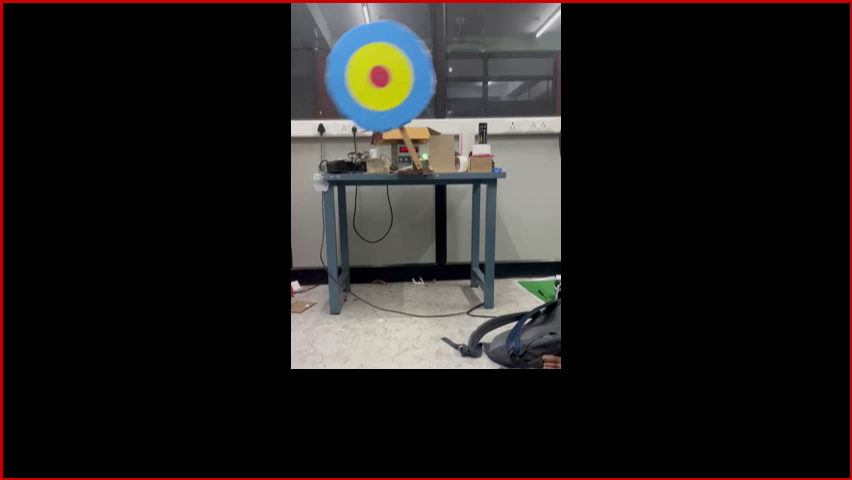

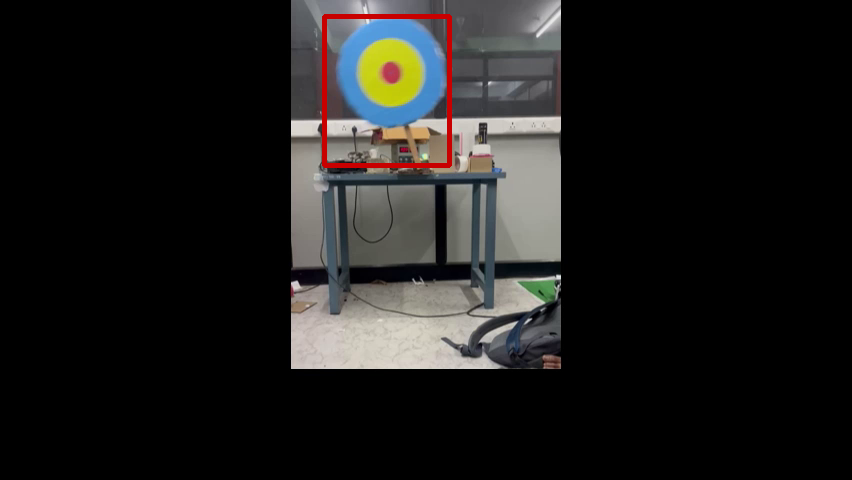

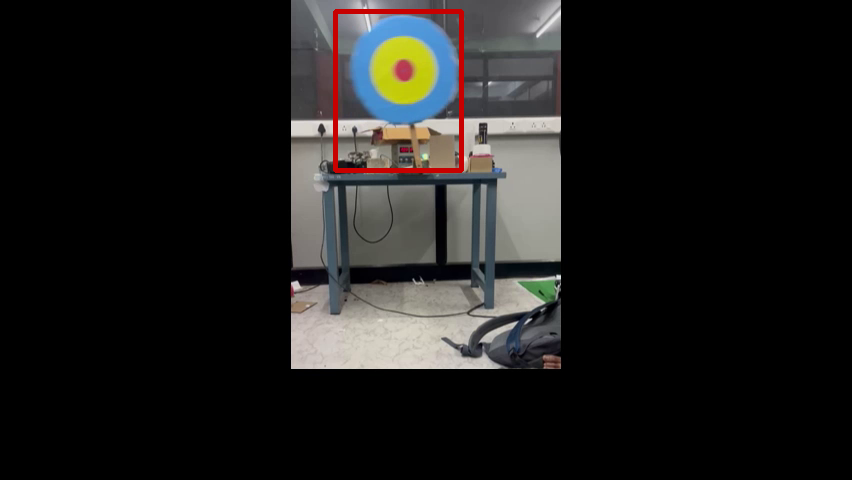

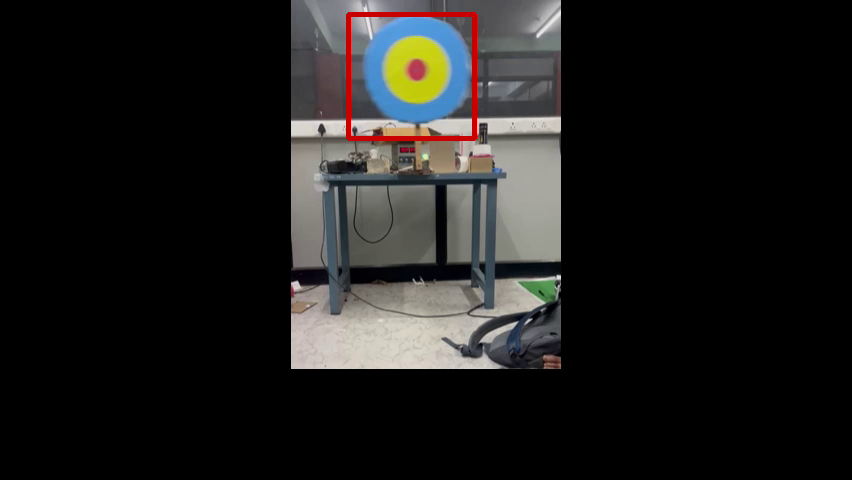

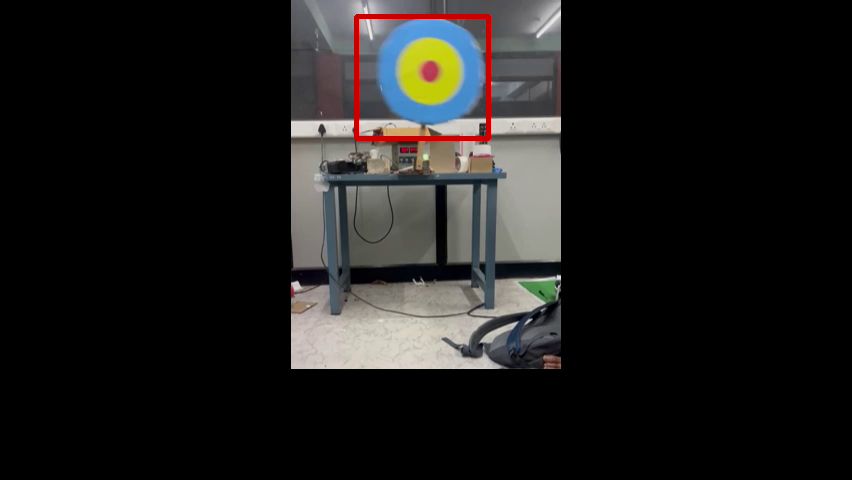

...

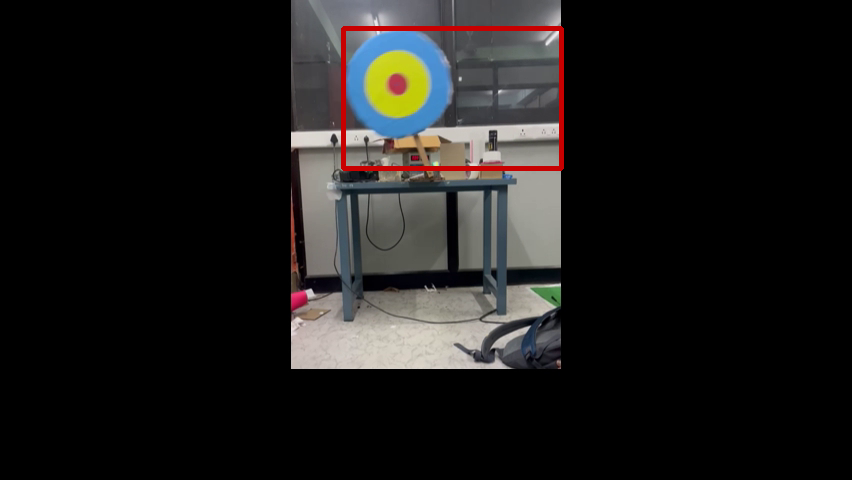

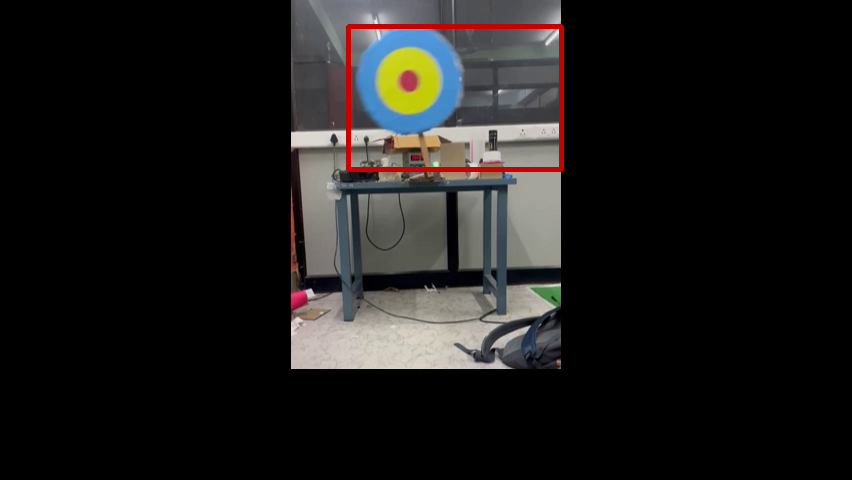

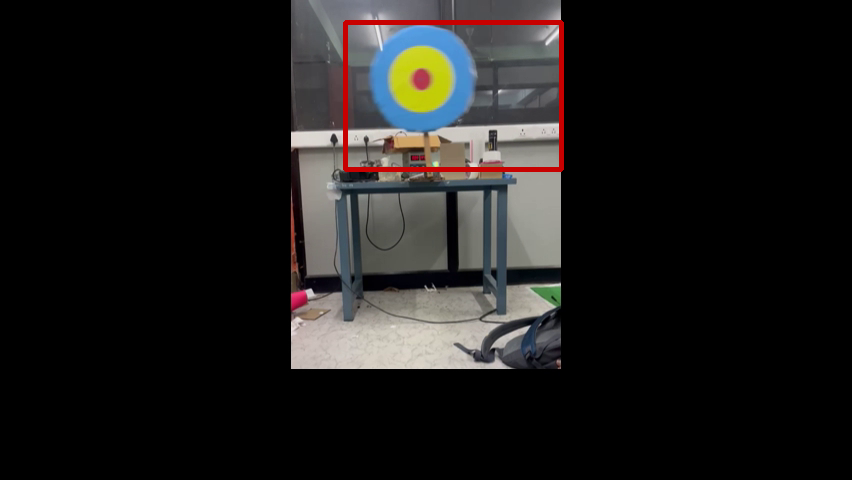

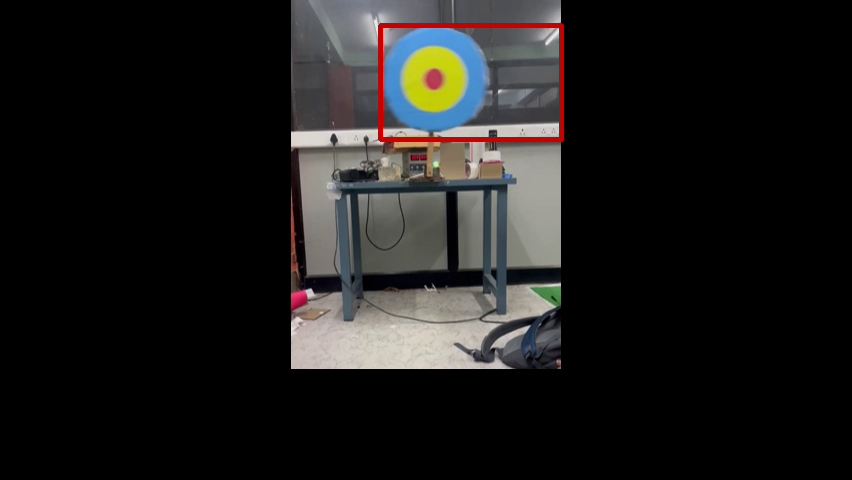

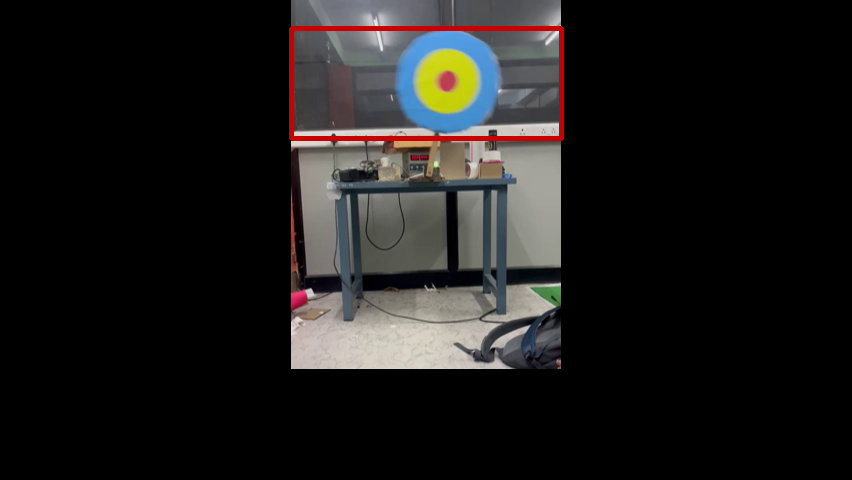

In [12]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Upload the file
from google.colab import files
uploaded = files.upload()

# Assuming the uploaded file is a video and there's only one file uploaded
vid_path = list(uploaded.keys())[0]

# Open the video file
cap = cv2.VideoCapture(vid_path)
backSub = cv2.createBackgroundSubtractorMOG2()

if not cap.isOpened():
    print("Error opening video file")
else:
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Apply background subtraction
        fg_mask = backSub.apply(frame)
        contours, hierarchy = cv2.findContours(fg_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        retval, mask_thresh = cv2.threshold( fg_mask, 180, 255, cv2.THRESH_BINARY)
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
        # Apply erosion
        mask_eroded = cv2.morphologyEx(mask_thresh, cv2.MORPH_OPEN, kernel)

        # Filter contours based on area
        min_contour_area = 1500  # Define your minimum area threshold
        large_contours = [cnt for cnt in contours if cv2.contourArea(cnt) > min_contour_area]

        frame_out = frame.copy()
        for cnt in large_contours:
            x, y, w, h = cv2.boundingRect(cnt)
            frame_out = cv2.rectangle(frame_out, (x, y), (x+w, y+h), (0, 0, 200), 3)


        # Display the resulting frame
        cv2_imshow(frame_out)

        # Delay to simulate video playback
        if cv2.waitKey(30) & 0xFF == ord('q'):
            break

cap.release()
cv2.destroyAllWindows()




